# Profiling running Python code with py-spy
If you have a Python program that is currently running you may want to understand what the real-world performance profile of the code is. This program could be in a production environment or just on your local machine. You will want to understand where the running program spends its time and if any "hot spots" exist that should be investigated further for improvement. You may be dealing with a production system that is misbehaving and you may want to profile it in an unobtrusive way that doesn't further impact production performance or require code modifications. What's a good way to do this? This article will talk about py-spy, a tool that allows you to profile Python programs that are already running.If you have python code already running in any situation, whether a production environment or not, you may want to be able to gain some insight into what the real-world performance profile of the code is. You want to understand where the running program is spending its time and if there are any "hot spots" or areas that should be investigated further for improvement. You may have a production system that is misbehaving and you'd like to understand what is happening, and do this in an unobtrusive way that doesn't impact production performance. What's a good way to do this? This article will talk about py-spy, a tool that helps you do this for Python programs.

## Deterministic vs. Sampling profilers

In earlier articles, we talked about two deterministic profilers, [cProfile](https://www.wrighters.io/profiling-python-with-cprofile-and-a-speedup-tip/) and [line_profiler](https://www.wrighters.io/profiling-python-code-with-line_profiler/). These profilers are useful when you are developing code and want to profile either sections of code or an entire process. Since they are deterministic, they will tell you exactly how many times a function (or in the case of ```line_profiler```, a line) is executed and how much time it *relatively* takes to execute to the rest of your code. Because these profiles run within the executing code, they slow down the process somewhat because they have to do the bookkeeping and calculating in the midst of the program executing. Since these profilers require code to be modified, and have to be enabled before the code is run, they are not usually suitable for profiling production code.

This is where sampling profilers can be helpful. A sampling profiler will look at an existing process and use various tricks to determine what the running process is doing. For example, on linux you can use the ```pstack <pid>``` (or ```gstack <pid>```) command to see what your process id is doing. On a Mac, you can execute ```echo "thread backtrace all" | lldb -p <pid>``` to see something similar. This works for any process, not just Python programs. In some cases, doing this a few times will give you an idea if your process is stuck, or where it is slow. But this is just a sample, and the process is continually executing and so your sample will be different each time you run this command (unless it's blocked or you just happened to be very lucky).

A sampling profiler and surrounding tools will essentially take multiple snapshots of the system over time and then provide you with the ability to look over this data and understand where your code is slow. 

## py-spy
The [py-spy](https://github.com/benfred/py-spy) sampling profiler allows you to visualize where a python program is spending its time without modifying the code or even restarting the process. It uses system calls (```process_vm_readv``` on Linux, ```vm_read``` on OSX, ```ReadProcessMemory``` on Windows) to obtain the call stack, then translates this to the Python function calls that you can see in your source code. It's written in Rust for speed.

Getting py-spy into your project is very simple, it's installable via ```pip```. To show you how to use it, I've created some sample code to illustrate how py-spy works and what it can tell us about a running Python process. If you want to follow along, you can reproduce these steps.

First, I setup a new virtual environment using [py-env](https://www.wrighters.io/you-can-easily-and-sensibly-run-multiple-versions-of-python-with-pyenv/) and the [pyenv-virtualenv plugin](https://www.wrighters.io/use-pyenv-and-virtual-environments-to-manage-python-complexity/) for this project. You can do this or setup a virtual environment using your preferred tool.

``` 
pyenv install 3.8.7             # this is the version I used for this example
pyenv virtualenv 3.8.7 py-spy   # make our virtualenv
pyenv activate py-spy           # activate it
pip install py-spy              # install it
pyenv rehash                    # make sure we pick up the commands in our path
```

That's all there is to it, we now have the tools available.  If you run py-spy, you can see the common usage.

```

$ py-spy
py-spy 0.3.4
Sampling profiler for Python programs

USAGE:
    py-spy <SUBCOMMAND>

OPTIONS:
    -h, --help       Prints help information
    -V, --version    Prints version information

SUBCOMMANDS:
    record    Records stack trace information to a flamegraph, speedscope or raw file
    top       Displays a top like view of functions consuming CPU
    dump      Dumps stack traces for a target program to stdout
    help      Prints this message or the help of the given subcommand(s)
```

## An example
Now, to demonstrate, I've written a simple long-running process. Let's say that I want to consume streaming prices from a cryptocurrency exchange and generate a record every minute (a.k.a a bar). The bar will contain the high, low, and last price, the volume, and the Volume Weighted Average Price (VWAP) of the bar. Every minute it will log these values. This code could be extended to update a database or other more permanent storage. But it is a good example to use since there is almost always some activity generating data to drive our program.

I'm using a [Coinbase Pro API](https://docs.pro.coinbase.com) for [Python](https://github.com/danpaquin/coinbasepro-python) to access data from the WebSocket feed. Here's a first cut that has some debugging code left in place (along with an inefficient and more efficient way to calculate the VWAP).

## Running the example

To run this code, you'll need to install a few extra modules.

```
pip install arrow cbpro
```

Now, you can run the code with debug logging and hopefully see some messages.

```
 ./coinbase_client.py -d
2021-03-14 17:20:12,828 - DEBUG -  Using selector: KqueueSelector
-- Subscribed! --

2021-03-14 17:20:13,059 - DEBUG -  Message: {'type': 'subscriptions', 'channels': [{'name': 'ticker', 'product_ids': ['BTC-USD']}]}
2021-03-14 17:20:13,060 - DEBUG -  VWAP: 60132.57
```

## Profiling the example
Now, let's review the py-spy commands. First, using the dump command will give us a quick view of the stack, translated to Python functions. 

A quick side note here, if you're using a Mac you will need to run py-spy as sudo. On Linux, it depends on your security settings. For me, since I was using pyenv, I needed to pass on my environment to sudo using the ```-E``` flag. I obtained the process id for my process using the ```ps``` command in my shell (in my case it was 97520). 

```
 sudo -E py-spy dump -p 97520
Process 97520: /Users/mcw/.pyenv/versions/py-spy/bin/python ./coinbase_client.py -d
Python v3.8.7 (/Users/mcw/.pyenv/versions/3.8.7/bin/python3.8)

Thread 0x113206DC0 (idle): "MainThread"
    select (selectors.py:558)
    _run_once (asyncio/base_events.py:1823)
    run_forever (asyncio/base_events.py:570)
    main (coinbase_client.py:107)
    <module> (coinbase_client.py:113)
Thread 0x700009CAA000 (idle): "Thread-1"
    read (ssl.py:1101)
    recv (ssl.py:1226)
    recv (websocket/_socket.py:80)
    _recv (websocket/_core.py:427)
    recv_strict (websocket/_abnf.py:371)
    recv_header (websocket/_abnf.py:286)
    recv_frame (websocket/_abnf.py:336)
    recv_frame (websocket/_core.py:357)
    recv_data_frame (websocket/_core.py:323)
    recv_data (websocket/_core.py:310)
    recv (websocket/_core.py:293)
    _listen (cbpro/websocket_client.py:84)
    _go (cbpro/websocket_client.py:41)
    run (threading.py:870)
    _bootstrap_inner (threading.py:932)
    _bootstrap (threading.py:890)
    
```

You can see there's two threads running, and one is reading data, the other is in ```select``` in the run loop. This would only be useful for profiling if our program was stuck. If you give it the ```--locals``` option, it will show you any local variables which can be really helpful.

The next command to try is ```top```. 

```
sudo -E py-spy top -p 97520
```

This will bring up an interface that looks very similar to the unix ```top``` command. As your program runs and samples are gathered, it will show you where it is spending time.  Here is what that looked like for me.

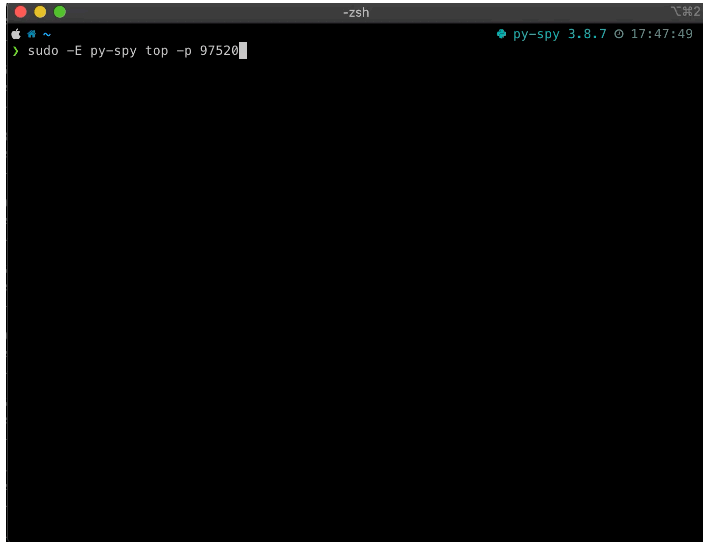


Finally, you can record data using py-spy for later analysis or output. There is a raw format, speedscope format, and a flamegraph output. You can specify the amount of time you want to collect data (in seconds), or just let it collect data until you exit the program using Ctrl-C. For example, this command will generate a useful little SVG file flamegraph that you can interact with in a web browser.

```
sudo -E py-spy record -p 97520 --output py-spy.svg
```

You can also export the data in [speedscope](https://www.speedscope.app) format and then upload it to the speedscope web tool for further analysis. This is a great tool for interactively seeing how your code executes.

I'd encourage you to run this code on your own and play with both the speedscope tool and the SVG output, but here's two screen shots that help explain how it works. This first view is the overall SVG output. If you hover over the cells, it will show you the function.

![flamegraph1.png](attachment:flamegraph1.png)

You can see that most of the time is spent in the WebSocket client ```_listen``` method. But the ```on_message``` method shows up to the right of that. If we click on it, we get a reduced view.

![flamegraph2.png](attachment:flamegraph2.png)


In my case, I see that my list comprehension and logging in the unneeded ```_vwap``` method shows up fairly high in the profile. I can easily remove this method (and the extra prices and volumes that I was tracking) since the VWAP can be calculated with just a running product and total volume (as I'm doing already). It's also interesting to see when the script is run in debug mode how much time logging takes.

I hope this overview of py-spy has been helpful and that you can deploy this tool in diagnosing performance issues in your own code.